# TTN遺伝子の両端の配列に着目しmotif配列の検出を行う

### intron_edge_motif_pca.ipynbの内容
各イントロン両端の特定の領域に存在する特徴的な配列を検出するために主成分分析を行う

### 準備
```
gbk = Seq_count() # クラスのインスタンス化
gbk.read_gbk('data/gbk/human_ttn.gb')　# gbkファイルの読み込み
```

### 特定のイントロン領域の組み合わせ配列の統計をデータフレームで返す
イントロン88のの配列の統計情報
組み合わせ配列の塩基数:4
```
gbk.intron_motif_stats(intron=88, n=4)
```

### 指定したインロンの配列を返す
```
gbk.intron_seq(77) # 77番目のイントロン配列を取得
```

## 準備

In [17]:
# オリジナルモジュールのインポート
from lib.introngap import PileUp
from lib.gbkparse import Seq_count

# モジュールのインポート
import itertools
import logomaker
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px

from sklearn.decomposition import PCA
from sklearn.preprocessing import StandardScaler

import warnings
warnings.simplefilter(action='ignore', category=FutureWarning)

In [18]:
# クラスのインスタンス化
gbk = Seq_count()

# gbkファイルの読み込み
gbk.read_gbk('../data/gbk/human_ttn.gb')

デフォルト値として、最もエクソンの多いNM_001267550.2を設定


In [19]:
# 各バリアントのエクソン数を取得
gbk.variant_exons()

{'NM_003319.4': 191,
 'NM_133437.4': 192,
 'NM_133432.3': 192,
 'NM_133378.4': 312,
 'XM_017004821.1': 336,
 'NM_001256850.1': 313,
 'NM_001267550.2': 363,
 'XM_017004820.1': 336,
 'XM_024453099.1': 191,
 'XM_017004823.1': 192,
 'XM_047445668.1': 277,
 'XM_024453098.1': 272,
 'XM_024453097.1': 273,
 'XM_017004822.1': 274,
 'XM_047445665.1': 282,
 'XM_047445663.1': 300,
 'XM_024453095.1': 310,
 'XM_047445660.1': 317,
 'XM_047445661.1': 313,
 'XM_017004819.1': 359,
 'NM_133379.5': 46,
 'XM_024453100.2': 184}

## すべてのイントロンの両端n塩基を抽出し、それらをもとに主成分分析を行う

In [20]:
# 各イントロンの両端n塩基を抽出し
n = 30

# 各イントロンの5-prime側のn塩基を抽出 
left_edges = []
for i in range(gbk.intron_num()):
    left_edges.append(str(gbk.intron_seq(i+1)[:n]))
    
# 各イントロンの3-prime側のn塩基を抽出
right_edges = []
for i in range(gbk.intron_num()):
    right_edges.append(str(gbk.intron_seq(i+1)[-n:]))

### 抽出した配列のワンホットエンコーディングと主成分分析
各イントロンの5-prime側のn塩基の主成分分析

In [21]:
# ワンホットエンコーディングを行う関数
def one_hot_encode(seq):
    mapping = {'A': [1, 0, 0, 0], 'T': [0, 1, 0, 0], 'G': [0, 0, 1, 0], 'C': [0, 0, 0, 1]}
    return np.array([mapping[s] for s in seq]).flatten()

# エンコーディングされた配列を準備
encoded_sequences = np.array([one_hot_encode(seq) for seq in left_edges])

# 主成分分析（PCA）
pca_l = PCA(n_components=2)  # 2つの主成分を取得
principal_components = pca_l.fit_transform(encoded_sequences)

# 主成分をデータフレームに変換
df_pca_l = pd.DataFrame(data=principal_components, columns=['PC1', 'PC2'])

# 結果をプロット
fig = px.scatter(df_pca_l, x='PC1', y='PC2', hover_name=[f"intron_{i+1}" for i in range(gbk.intron_num())] )
fig.show()


In [22]:
# 各イントロンのPC1の値を棒グラフにする
fig = px.bar(x=df_pca_l.index, y=df_pca_l['PC1'])
fig.show()

In [23]:
# 各バリアントのエクソンを表示
gbk.transcript_variants()

デフォルト値として、最もエクソンの多いNM_001267550.2を設定


In [24]:
# 因子負荷量の計算
loadings_l = pca_l.components_.T * np.sqrt(pca_l.explained_variance_)

# 因子負荷量を縦軸に棒グラフを作成
loadings_ldf = pd.DataFrame(loadings_l, columns=['PC1', 'PC2'])
ldf_l = pd.DataFrame(loadings_ldf)
ldf_l.sort_values('PC1')
fig = px.bar(x=ldf_l.index, y=ldf_l['PC1'])
fig.show()

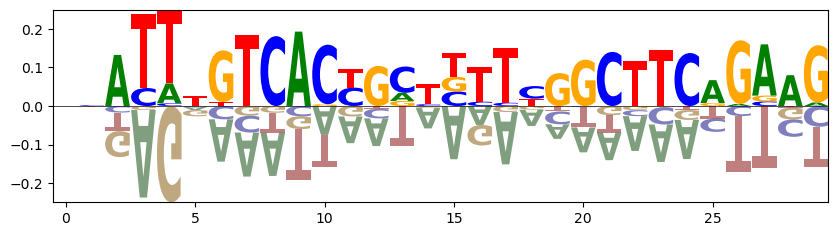

In [25]:
# ワンホットエンコーディングをデコードする
# 負荷量の最も高い塩基を取得し、配列を作成する
b_df_l = pd.DataFrame(ldf_l['PC1'].to_numpy().reshape(n,4))
b_df_l.columns = ['A','T','G','C']
crp_logo = logomaker.Logo(b_df_l, shade_below=.5, fade_below=.5)

各イントロンの3-prime側のn塩基の主成分分析

In [26]:
# ワンホットエンコーディングを行う関数
def one_hot_encode(seq):
    mapping = {'A': [1, 0, 0, 0], 'T': [0, 1, 0, 0], 'G': [0, 0, 1, 0], 'C': [0, 0, 0, 1]}
    return np.array([mapping[s] for s in seq]).flatten()

# エンコーディングされた配列を準備
encoded_sequences = np.array([one_hot_encode(seq) for seq in right_edges])

# 主成分分析（PCA）
pca_r = PCA(n_components=2)  # 2つの主成分を取得
principal_components = pca_r.fit_transform(encoded_sequences)

# 主成分をデータフレームに変換
df_pca_r = pd.DataFrame(data=principal_components, columns=['PC1', 'PC2'])

# 結果をプロット
fig = px.scatter(df_pca_r, x='PC1', y='PC2', hover_name=[f"intron_{i+1}" for i in range(gbk.intron_num())] )
fig.show()

In [27]:
# 各イントロンのPC1の値を棒グラフにする
fig = px.bar(x=df_pca_r.index, y=df_pca_r['PC1'])
fig.show()

In [28]:
# 各バリアントのエクソンを表示
gbk.transcript_variants()

デフォルト値として、最もエクソンの多いNM_001267550.2を設定


In [29]:
# 因子負荷量の計算
loadings_r = pca_r.components_.T * np.sqrt(pca_r.explained_variance_)

# 因子負荷量を縦軸に棒グラフを作成
loadings_rdf = pd.DataFrame(loadings_r, columns=['PC1', 'PC2'])
ldf_r = pd.DataFrame(loadings_rdf)
ldf_r.sort_values('PC1')
fig = px.bar(x=ldf_r.index, y=ldf_r['PC1'])
fig.show()

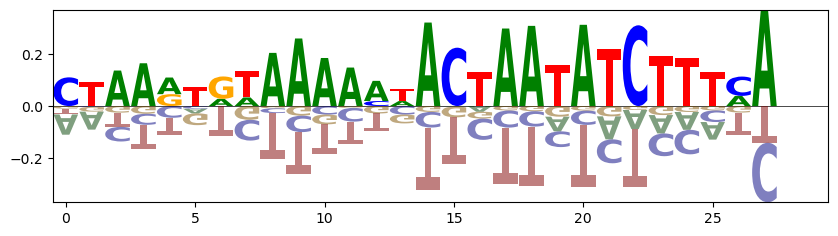

In [30]:
# ワンホットエンコーディングをデコードする
# 負荷量の最も高い塩基を取得し、配列を作成する
b_df_r = pd.DataFrame(ldf_r['PC1'].to_numpy().reshape(n,4))
b_df_r.columns = ['A','T','G','C']
crp_logo = logomaker.Logo(b_df_r, shade_below=.5, fade_below=.5)

In [31]:
# 上記の配列の一部が末尾n塩基に含まれているイントロンを抽出
mtf = "ACTAATATCTT"
for i in range(gbk.intron_num()):
    if mtf in gbk.intron_seq(i+1)[-n:]:
        print(f"intron_{i+1}の末尾{n}塩基")
        seq = str(gbk.intron_seq(i+1)[-n:])
        seq = seq.replace(mtf,f"<{mtf}>")
        print(seq)
        print("")

intron_155の末尾30塩基
TTCTAAACCAAAAT<ACTAATATCTT>TGAAG

intron_158の末尾30塩基
GTAACAATTAATAT<ACTAATATCTT>TAAAG

intron_159の末尾30塩基
CTAATTATTTAAAT<ACTAATATCTT>TAAAG

intron_161の末尾30塩基
TTAAATGTAAACCT<ACTAATATCTT>TAAAG

intron_162の末尾30塩基
CAATTAAAAAAAAT<ACTAATATCTT>TAAAG

intron_164の末尾30塩基
CCTCTAACCATAAT<ACTAATATCTT>CAAAG

intron_168の末尾30塩基
CTGAGTGTAAAAAT<ACTAATATCTT>TCAAG

intron_169の末尾30塩基
CTAAATGTAATTTC<ACTAATATCTT>TCAAG

intron_171の末尾30塩基
CTAAATGTAATTTC<ACTAATATCTT>TCAAG

intron_172の末尾30塩基
CTAATAATGAAAAT<ACTAATATCTT>TAAAG

intron_174の末尾30塩基
TCTAACTAAAAGAT<ACTAATATCTT>CAAAG

intron_175の末尾30塩基
TAAATTATAAAAAT<ACTAATATCTT>TCAAG

intron_176の末尾30塩基
CTAAGTATAAAACT<ACTAATATCTT>TCAAG

intron_177の末尾30塩基
TTAAGTCTAAAACT<ACTAATATCTT>TCAAG

intron_178の末尾30塩基
CTAAGTGAAAAACT<ACTAATATCTT>TCAAG

intron_179の末尾30塩基
CCACATGTAACTTT<ACTAATATCTT>TTAAG

intron_180の末尾30塩基
CTAAATGTAATTTC<ACTAATATCTT>TCAAG

intron_181の末尾30塩基
CTAATAATGAAAAT<ACTAATATCTT>TAAAG

intron_183の末尾30塩基
TCTAACTAAAAGAT<ACTAATATCTT>CAAAG

intron_184の末

In [32]:
# 上記の配列の一部を含むイントロンの部位を可視化
gbk.set_interest_seq('ACTAATATCTT')
gbk.heatmap()

## Proporton Spliced In
参考論文 [Contribution of Noncanonical Splice Variants to TTN Truncating Variant Cardiomyopathy](https://www.ahajournals.org/doi/full/10.1161/CIRCGEN.121.003389)<br>
<br>
**Figure 5A:**<br>
[GTEX](https://gtexportal.org/home/)データベース情報をもとに骨格筋、左心室心筋、右心房心筋のmRNAのスプライスインされたエクソンの割合を示すグラフ

![PSI](../data/pic/Figure5A.png)